### Kevin Ahmadiputra | TP058396 | CNN Model

In [1]:
#INSTALL REQUIRED PACKAGES AND LIBRARIES
# !pip install opencv-python
# !pip install matplotlib
# !pip install scikit-learn
# !pip install seaborn

In [1]:
#IMPORT LIBRARIES
import tensorflow as tf
import seaborn as sns
import numpy as np
import pandas as pd
import os
import imghdr
import cv2
from matplotlib import pyplot as plt
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from tensorflow.keras.metrics import Precision, Recall, Accuracy
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, Dropout, BatchNormalization
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.resnet50 import ResNet50

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_20680\3597571382.py:7: DeprecationWarning: 'imghdr' is deprecated and slated for removal in Python 3.13
  import imghdr


In [4]:
#Avoid OOM Erros by Setting CPU Memory Consumption Growth
gpus = tf.config.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
gpus

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [29]:
#PARAMETERS
b_size = 32
img_height = 256
img_width = 256
img_size = (img_height, img_width)
epochs = 40
train_size = 0.8
val_size =0.1
test_size = 0.1

#Data Directory
model_dir = 'models'
data_dir_leaf ='FYP_DATASET\\leaf'
data_dir_segment = 'FYP_DATASET\\leaf-segmented'

leaf_logdir = 'CNN_Logs\\Logs_Leaf'

cnn_leaf = 'CNN-LEAF.h5'
cnn_leaf_cp ="CNN-LEAF-Epoch-{epoch:02d}.h5"

cnn_leaf_vgg16 = 'CNN-LEAF-VGG16.h5'
cnn_leaf_vgg16_cp ="CNN-LEAF-VGG16-Epoch-{epoch:02d}.h5"

cnn_leaf_res50 = 'CNN-LEAF-RESNET50.h5'
cnn_leaf_res50_cp ="CNN-LEAF-RESNET50-Epoch-{epoch:02d}.h5"

#Image Extension
img_extend = ['jpg', 'jpeg', 'png']

In [13]:
#List all folder in data_dir with name Leaves
leaf_list = os.listdir(data_dir_leaf)
leaf_num = len(leaf_list)

print("LEAF\nNumber of Classes = ", leaf_num)
cnt = 0
for i in leaf_list:
    print(cnt, "-->", i)
    cnt = cnt + 1

LEAF
Number of Classes =  11
0 --> Leaves_apple_cedar_apple_rust
1 --> Leaves_apple_healthy
2 --> Leaves_apple_scab
3 --> Leaves_grape_black_rot
4 --> Leaves_grape_healthy
5 --> Leaves_grape_leaf_blight
6 --> Leaves_potato_early_blight
7 --> Leaves_potato_healthy
8 --> Leaves_potato_late_blight
9 --> Leaves_strawberry_healthy
10 --> Leaves_strawberry_leaf_scorch


In [7]:
#Count Image per Class
print("LEAF - Images")
for i in leaf_list:
    img_cnt = 0
    for j in os.listdir(os.path.join(data_dir_leaf,i)):
        if imghdr.what(os.path.join(data_dir_leaf,i,j)) in img_extend:
            img_cnt += 1
    print(i, '--->',img_cnt)

LEAF - Images
Leaves_apple_cedar_apple_rust ---> 1514
Leaves_apple_healthy ---> 2145
Leaves_apple_scab ---> 1500
Leaves_grape_black_rot ---> 1680
Leaves_grape_healthy ---> 1500
Leaves_grape_leaf_blight ---> 1576
Leaves_potato_early_blight ---> 1500
Leaves_potato_healthy ---> 1500
Leaves_potato_late_blight ---> 1500
Leaves_strawberry_healthy ---> 1500
Leaves_strawberry_leaf_scorch ---> 1609


## 1.0 Data Pre-Processing

#### Image Segmentation (GrabCut) 

In [619]:
for i in leaf_list:
    for j in os.listdir(os.path.join(data_dir_segment,i)):
        if imghdr.what(os.path.join(data_dir_segment,i,j)) in img_extend:
            filename = os.path.join(data_dir_segment,i,j)
            image = cv2.imread(filename)
            image = cv2.resize(image, (256, 256))
            # Create a mask to specify which areas are background, foreground, etc.
            mask = np.zeros(image.shape[:2], np.uint8)

            # Define the rectangle encompassing the foreground object (in this case, the leaf)
            rectangle = (2, 2, 251, 251)  # (x, y, width, height)

            # Apply GrabCut algorithm
            bgd_model = np.zeros((1, 65), np.float64)
            fgd_model = np.zeros((1, 65), np.float64)
            cv2.grabCut(image, mask, rectangle, bgd_model, fgd_model, 5, cv2.GC_INIT_WITH_RECT)

            # Create a mask that labels the foreground and probable foreground regions as likely foreground
            foreground_mask = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')

            # Apply the mask to the original image to remove the background
            segmented_image = image * foreground_mask[:, :, np.newaxis]
            
            cv2.imwrite(filename, segmented_image)
                

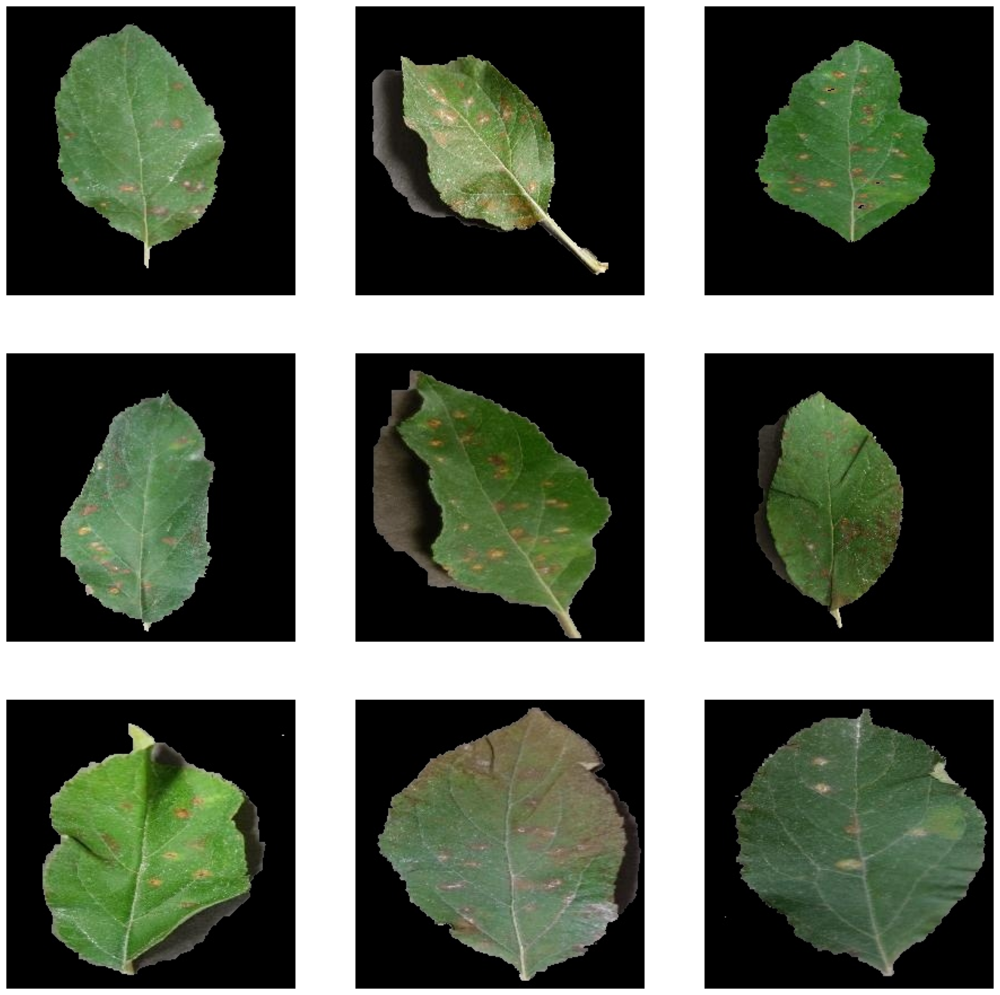

In [634]:
# Define the number of images to display
num_images_to_display = 9

# Initialize a counter to keep track of the displayed images
displayed_images = 0
plt.figure(figsize=(20, 20))

# Iterate through the directories and image files
for i in leaf_list:
    for j in os.listdir(os.path.join(data_dir_segment, i)):
        if displayed_images >= num_images_to_display:
            break
        
        image_path = os.path.join(data_dir_segment, i, j)
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Display the image
        plt.subplot(3, 3, displayed_images + 1)
        plt.imshow(image)
        plt.axis('off')
        
        displayed_images += 1

plt.show()

#### Mix Segmented & Initial Dataset

In [6]:
#Mix Segmented Image with Initial Image Dataset
for i in leaf_list:
    cnt = 500
    for k in os.listdir(os.path.join(data_dir_segment, i)):
        if cnt != 0:
            filename = os.path.join(data_dir_segment, i, k)
            new_filename = os.path.join(data_dir_leaf, i, k)
            image = cv2.imread(filename)
            segmented_filename = os.path.splitext(new_filename)[0] + "_segmented" + '.jpg'
            cv2.imwrite(segmented_filename, image)
            cnt -= 1
        else:
            break

#### Load Data

In [30]:
#DATA PIPELINE --> Get Data
data_leaf = tf.keras.preprocessing.image_dataset_from_directory(data_dir_leaf, image_size=img_size, batch_size=b_size, shuffle=True)

Found 17524 files belonging to 11 classes.


In [31]:
#Review Class In Data
data_leaf.class_names

['Leaves_apple_cedar_apple_rust',
 'Leaves_apple_healthy',
 'Leaves_apple_scab',
 'Leaves_grape_black_rot',
 'Leaves_grape_healthy',
 'Leaves_grape_leaf_blight',
 'Leaves_potato_early_blight',
 'Leaves_potato_healthy',
 'Leaves_potato_late_blight',
 'Leaves_strawberry_healthy',
 'Leaves_strawberry_leaf_scorch']

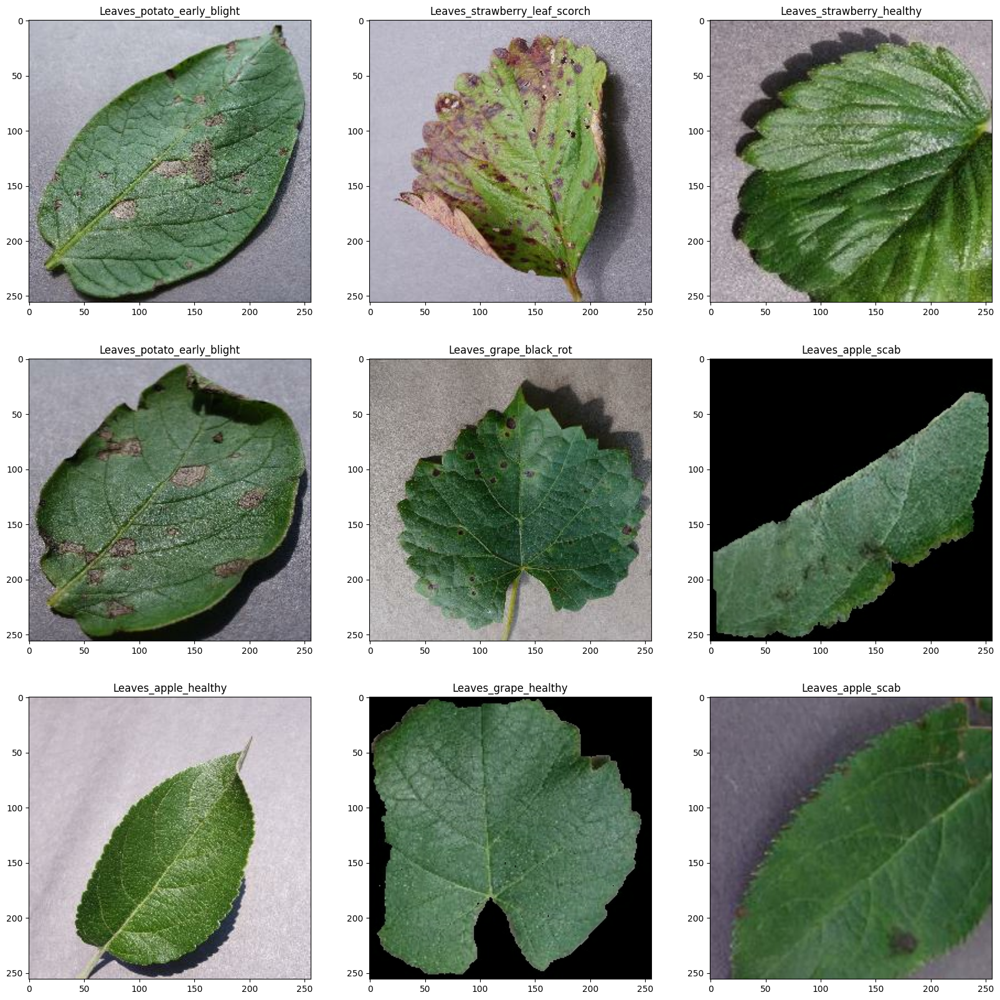

In [7]:
#Review Image in Dataset Leaf
plt.figure(figsize=(20, 20))
for images, labels in data_leaf.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(leaf_list[labels[i]])
        #plt.axis("off")

#### Image Augmentation

In [32]:
# Image Augmentation
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomFlip("horizontal"),
    tf.keras.layers.experimental.preprocessing.RandomFlip("vertical"),
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.2),
    tf.keras.layers.experimental.preprocessing.RandomContrast(0.2),
])

# Apply Image Augmentation to Dataset
data_leaf = data_leaf.map(lambda x, y: (data_augmentation(x, training=True), y))

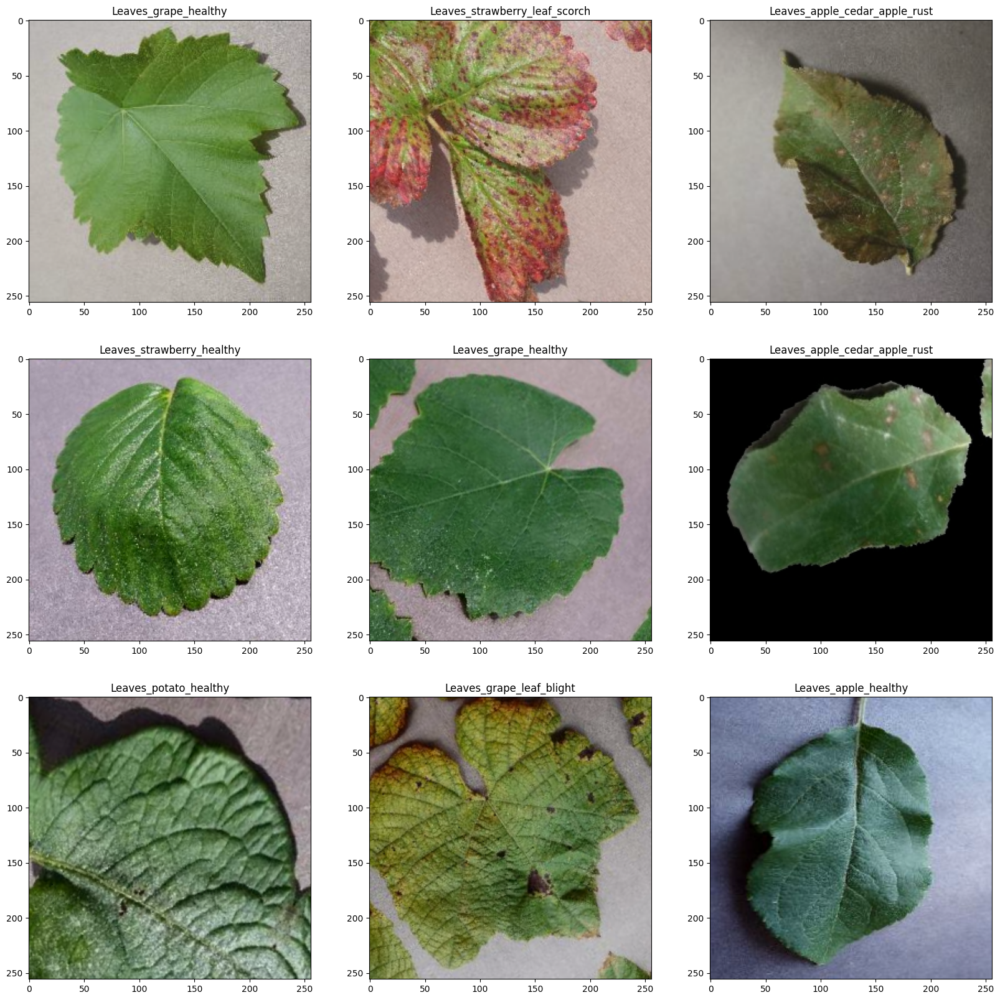

In [34]:
#Review Image in Dataset after CenterCrop
plt.figure(figsize=(20, 20))
for images, labels in data_leaf.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(leaf_list[labels[i]])
        #plt.axis("off")

#### Resizing & Rescaling (Normalization)

In [9]:
print('Data Leaf --> ', data_leaf.as_numpy_iterator().next()[0].min(), data_leaf.as_numpy_iterator().next()[0].max())

Data Leaf -->  0.0 255.0


In [33]:
# Image Augmentation
data_norm = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.Resizing(img_width, img_height),
    tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
])

# Apply Image Augmentation to Dataset
data_leaf = data_leaf.map(lambda x, y: (data_norm(x, training=True), y))

In [89]:
for i in range(10):
#Check Max & Min Scale
    print('Data Leaf --> ', data_leaf.as_numpy_iterator().next()[0].min(), data_leaf.as_numpy_iterator().next()[0].max())

Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0
Data Leaf -->  0.0 1.0


#### Split Data

In [34]:
#Check Data Batches
print('Data Leaf -- > ', len(data_leaf))

Data Leaf -- >  548


In [35]:
#Calculate & Set Split Amount
leaf_train  = int(train_size * len(data_leaf))
leaf_val = int(val_size * len(data_leaf))+1
leaf_test = int(test_size * len(data_leaf))+1

print('Leaf --> ', leaf_train, leaf_val, leaf_test, ( leaf_train + leaf_val + leaf_test))

Leaf -->  438 55 55 548


In [36]:
#Split Dataset
data_leaf_train = data_leaf.take(leaf_train)
data_leaf_val = data_leaf.skip(leaf_train).take(leaf_val)
data_leaf_test = data_leaf.skip(leaf_train + leaf_val).take(leaf_test)

print('Leaf --> ', len(data_leaf_train), len(data_leaf_val), len(data_leaf_test))

Leaf -->  438 55 55


In [37]:
#Autotune
AUTOTUNE = tf.data.experimental.AUTOTUNE

#Configure Dataset for Performance
data_leaf_train = data_leaf_train.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
data_leaf_val = data_leaf_val.cache().prefetch(buffer_size=AUTOTUNE)
data_leaf_test = data_leaf_test.cache().prefetch(buffer_size=AUTOTUNE)

print('Leaf --> ', len(data_leaf_train), len(data_leaf_val), len(data_leaf_test))

Leaf -->  438 55 55


In [19]:
#CHECK DATA SHAPE
test_element = data_leaf_test.take(1)
test_batch = next(iter(test_element))
print(test_batch[0].shape)  # Shape of the image batch
print(test_batch[1].shape)  # Shape of the labels batch

(32, 256, 256, 3)
(32,)


## 2.0 Model - CNN

### 2.1 Custom Model

#### 2.1.1  Custom Model - Build

In [11]:
def create_model():
    #Sequential Model
    leaf_model = tf.keras.Sequential()

    #Layers [Can Change, Depend on Architecture, Hyperparameter]
    #Input Layer --> Note: 32 = filter ||  (3,3) = pixel in size/kernel size || 1 = stripe  || relu = activation type
    leaf_model.add(Conv2D(32, (3, 3), strides = 1, padding ='same', activation='relu', input_shape=(img_width, img_height, 3))) 
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2)) #Pooling to Condense Informations

    #Convolutional layers
    leaf_model.add(Conv2D(64, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    leaf_model.add(Conv2D(128, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    leaf_model.add(Conv2D(256, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    leaf_model.add(Conv2D(512, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    leaf_model.add(Conv2D(512, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    leaf_model.add(Conv2D(1024, (3, 3), strides = 1, padding ='same', activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(MaxPooling2D(2,2))

    #Flatten Layer --> Flatten the output from convolutional layers
    leaf_model.add(Flatten())

    #Fully Connected Layer --> Dense Layer
    leaf_model.add(Dense(1024, activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(Dropout(0.5))
    leaf_model.add(Dense(32, activation='relu'))
    leaf_model.add(BatchNormalization())
    leaf_model.add(Dropout(0.5))

    #Output Layer --> sigmoid for binary, softmax for multi class
    leaf_model.add(Dense(leaf_num, activation='softmax')) 

    #Compile Model --> Note: Adam as Optimizer
    initial_learning_rate = 0.001
    leaf_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=initial_learning_rate), loss="sparse_categorical_crossentropy", metrics=['accuracy'])
    
    return leaf_model

In [12]:
leaf_model = create_model()

In [13]:
#Display Model Summary
leaf_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 256, 256, 32)      896       
                                                                 
 batch_normalization_9 (Batc  (None, 256, 256, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 128, 128, 32)     0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 128, 128, 64)      18496     
                                                                 
 batch_normalization_10 (Bat  (None, 128, 128, 64)     256       
 chNormalization)                                                
                                                      

#### 2.1.2 Custom Model -  Train 

In [20]:
#TensorBoard Logs =--> Check Points to Check How Model Perform
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = leaf_logdir)

#Early Stopping
# from tensorflow.keras.callbacks import EarlyStopping
# early_stopping = EarlyStopping(monitor='val_accuracy', patience=2, restore_best_weights=False)

#Model Checkpoint
from tensorflow.keras.callbacks import ModelCheckpoint
model_cp = ModelCheckpoint(os.path.join(model_dir, cnn_leaf_cp), monitor='val_accuracy', verbose = 1, save_best_only=True, mode='max')

In [21]:
#Run Model (Train) --> epochs = how long train will run... 1 epochs = 1 full run (all batches)
history_leaf = leaf_model.fit(data_leaf_train, epochs=epochs, validation_data=data_leaf_val, callbacks=[tensorboard_callback, model_cp])

Epoch 1/40
438/438 [==============================] - ETA: 0s - loss: 1.2172 - accuracy: 0.6164
Epoch 1: val_accuracy improved from -inf to 0.13466, saving model to models\CNN-LEAF-Epoch-01.h5
438/438 [==============================] - 206s 295ms/step - loss: 1.2172 - accuracy: 0.6164 - val_loss: 5.0234 - val_accuracy: 0.1347
Epoch 2/40
438/438 [==============================] - ETA: 0s - loss: 0.5450 - accuracy: 0.8470
Epoch 2: val_accuracy improved from 0.13466 to 0.88523, saving model to models\CNN-LEAF-Epoch-02.h5
438/438 [==============================] - 72s 164ms/step - loss: 0.5450 - accuracy: 0.8470 - val_loss: 0.3534 - val_accuracy: 0.8852
Epoch 3/40
438/438 [==============================] - ETA: 0s - loss: 0.3566 - accuracy: 0.9011
Epoch 3: val_accuracy did not improve from 0.88523
438/438 [==============================] - 53s 121ms/step - loss: 0.3566 - accuracy: 0.9011 - val_loss: 0.6040 - val_accuracy: 0.8182
Epoch 4/40
438/438 [==============================] - ETA: 0s

Epoch 29/40
438/438 [==============================] - ETA: 0s - loss: 0.0333 - accuracy: 0.9915
Epoch 29: val_accuracy did not improve from 0.99091
438/438 [==============================] - 52s 118ms/step - loss: 0.0333 - accuracy: 0.9915 - val_loss: 0.1286 - val_accuracy: 0.9670
Epoch 30/40
438/438 [==============================] - ETA: 0s - loss: 0.0219 - accuracy: 0.9944
Epoch 30: val_accuracy did not improve from 0.99091
438/438 [==============================] - 52s 118ms/step - loss: 0.0219 - accuracy: 0.9944 - val_loss: 0.2247 - val_accuracy: 0.9494
Epoch 31/40
438/438 [==============================] - ETA: 0s - loss: 0.0241 - accuracy: 0.9944
Epoch 31: val_accuracy did not improve from 0.99091
438/438 [==============================] - 52s 118ms/step - loss: 0.0241 - accuracy: 0.9944 - val_loss: 1.6044 - val_accuracy: 0.7966
Epoch 32/40
438/438 [==============================] - ETA: 0s - loss: 0.0270 - accuracy: 0.9927
Epoch 32: val_accuracy did not improve from 0.99091
43

In [22]:
#Print History
history_leaf.history

{'loss': [1.2172483205795288,
  0.5450277328491211,
  0.3565957844257355,
  0.24840325117111206,
  0.2145298421382904,
  0.17575785517692566,
  0.15188568830490112,
  0.11507522314786911,
  0.10130319744348526,
  0.0832676813006401,
  0.0982845276594162,
  0.059870123863220215,
  0.0928259789943695,
  0.06585721671581268,
  0.044694337993860245,
  0.04498220980167389,
  0.05458458513021469,
  0.057528674602508545,
  0.03723820671439171,
  0.04679442569613457,
  0.02751876413822174,
  0.029947664588689804,
  0.036638032644987106,
  0.03624855726957321,
  0.02923099882900715,
  0.015772609040141106,
  0.02145533449947834,
  0.040354952216148376,
  0.03325021266937256,
  0.02191082015633583,
  0.024079062044620514,
  0.026955487206578255,
  0.012598084285855293,
  0.013299898244440556,
  0.004051811993122101,
  0.0023931502364575863,
  0.002513896208256483,
  0.07658307254314423,
  0.01852582022547722,
  0.006941207684576511],
 'accuracy': [0.616366982460022,
  0.8469606041908264,
  0.901

In [23]:
#Model History in Dataframe
history_leaf_df = pd.DataFrame(history_leaf.history)
history_leaf_df

,loss,accuracy,val_loss,val_accuracy
0,1.217248,0.616367,5.023364,0.134659
1,0.545028,0.846961,0.353351,0.885227
2,0.356596,0.901113,0.604023,0.818182
3,0.248403,0.932006,0.424097,0.876136
4,0.214530,0.943279,0.400859,0.888636
5,0.175758,0.949914,0.143752,0.950568
6,0.151886,0.960046,0.490191,0.877841
7,0.115075,0.968964,0.366033,0.903409
8,0.101303,0.973459,0.633927,0.823864
9,0.083268,0.978453,0.296283,0.919886


#### 2.1.3 Custom Model - Evaluate 

##### 2.1.3.1 Plot Performance

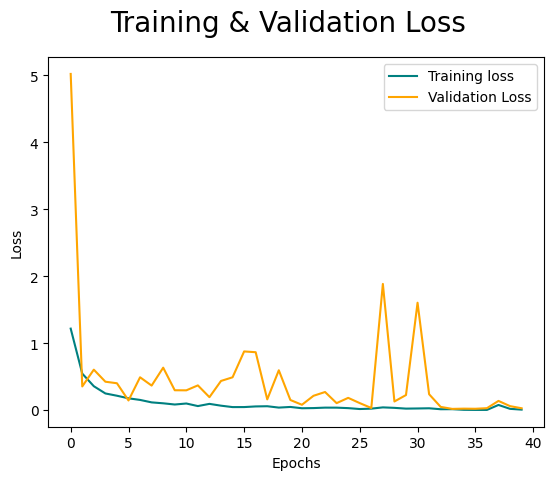

In [24]:
#Model Loss Plot
fig = plt.figure()
plt.plot(history_leaf.history['loss'], color='teal', label ='loss')
plt.plot(history_leaf.history['val_loss'], color='orange', label ='val_loss')
fig.suptitle('Training & Validation Loss', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['Training loss','Validation Loss'], loc = 'upper right')
plt.show()

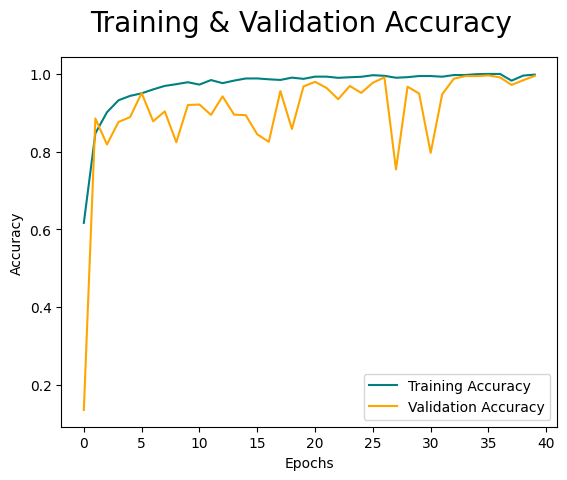

In [25]:
#Model Accuracy Plot
fig = plt.figure()
plt.plot(history_leaf.history['accuracy'], color='teal', label ='accuracy')
plt.plot(history_leaf.history['val_accuracy'], color='orange', label ='val_accuracy')
fig.suptitle('Training & Validation Accuracy', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['Training Accuracy','Validation Accuracy'], loc = 'lower right')
plt.show()

##### 2.1.3.2 Metrics

In [41]:
#Evaluate Model with Test Data
loss, acc = leaf_model.evaluate(data_leaf_test)
print('Accuracy Test: ',acc)
print('Loss Test: ',loss)

55/55 [==============================] - 81s 307ms/step - loss: 0.0993 - accuracy: 0.9746
Accuracy Test:  0.9746251702308655
Loss Test:  0.09932504594326019


##### 2.1.3.3 Classification Report

In [42]:
#Classification Report --> Usinng Test Data
from sklearn.metrics import classification_report
test_images = []
test_labels = []

for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())

test_images = np.array(test_images)
test_labels = np.array(test_labels)

predictions = np.argmax(leaf_model.predict(data_leaf_test), axis=-1)

predicted_class_names = [leaf_list[label] for label in predictions]
true_class_names = [leaf_list[label] for label in test_labels]
report = classification_report(true_class_names, predicted_class_names)
print(report)

55/55 [==============================] - 12s 217ms/step
                               precision    recall  f1-score   support

Leaves_apple_cedar_apple_rust       1.00      0.99      0.99       151
         Leaves_apple_healthy       0.98      0.98      0.98       215
            Leaves_apple_scab       0.95      0.95      0.95       148
       Leaves_grape_black_rot       0.99      0.99      0.99       172
         Leaves_grape_healthy       0.98      1.00      0.99       133
     Leaves_grape_leaf_blight       1.00      0.99      0.99       151
   Leaves_potato_early_blight       0.97      0.96      0.97       163
        Leaves_potato_healthy       0.97      0.92      0.95       157
    Leaves_potato_late_blight       0.89      0.97      0.93       149
    Leaves_strawberry_healthy       0.99      0.99      0.99       149
Leaves_strawberry_leaf_scorch       1.00      0.99      0.99       146

                     accuracy                           0.97      1734
                   

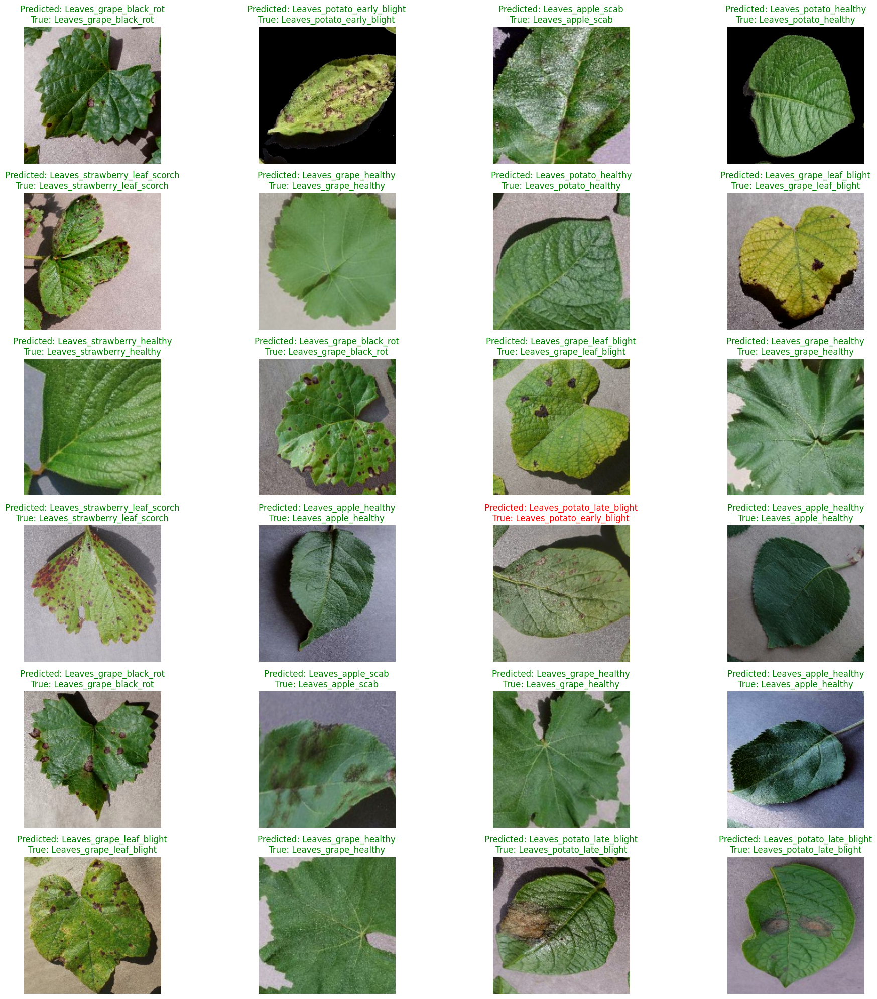

In [43]:
#Test Sample
plt.figure(figsize=(20, 20))
for i in range(24):
    ax = plt.subplot(6, 4, i + 1)
    plt.imshow(test_images[i])
    if predicted_class_names[i] == true_class_names[i]:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='green')
    else:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='red')
    plt.axis("off")
plt.tight_layout()
plt.show()

##### 2.1.3.4 Confusion Matrix

55/55 [==============================] - 12s 217ms/step


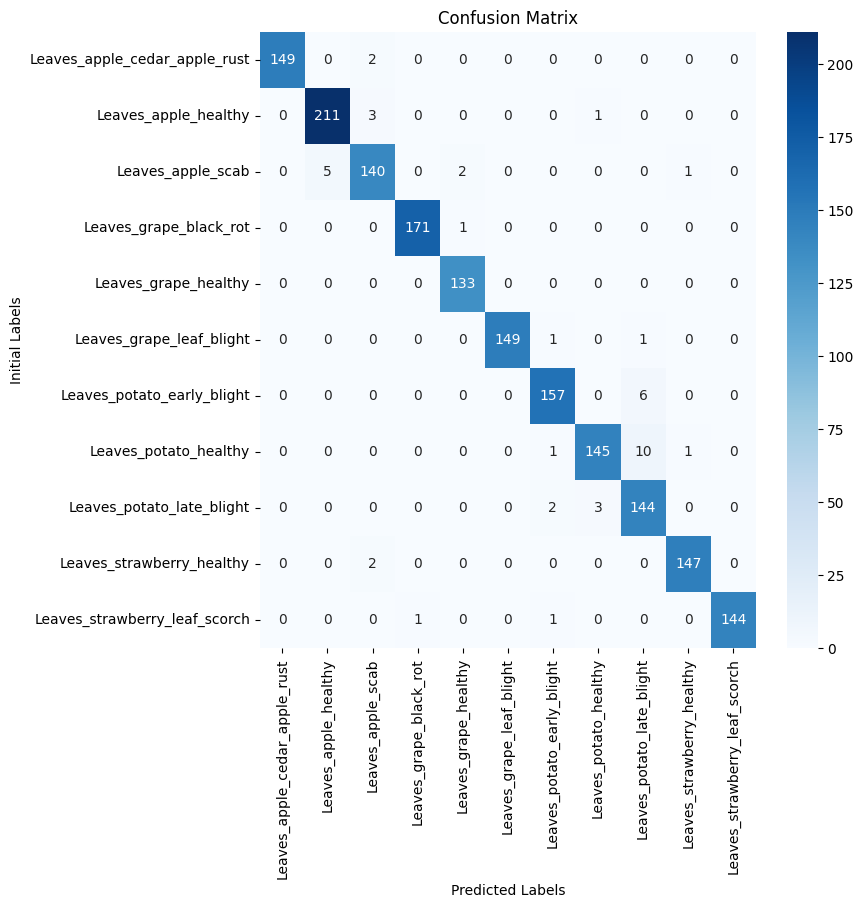

In [44]:
#Confusion Matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
test_images = []
test_labels = []
for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())
test_images = np.array(test_images)
test_labels = np.array(test_labels)
test_predictions = np.argmax(leaf_model.predict(data_leaf_test), axis=-1)

cm = confusion_matrix(test_labels, test_predictions)
# Plot the confusion matrix
plt.figure(figsize=(8, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=leaf_list, yticklabels=leaf_list)
plt.xlabel("Predicted Labels")
plt.ylabel("Initial Labels")
plt.title("Confusion Matrix")
plt.show()

#### Cross Validation

In [12]:
#Early Stopping
from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='loss', patience=2, restore_best_weights=False)

# Define lists to store evaluation metrics
validation_losses = []
validation_accuracies = []

# Define the number of folds
k = 5

# Get the total number of samples in your dataset
num_samples = len(data_leaf)

# Calculate the number of samples in each fold
fold_size = num_samples // k

# Shuffle the data
data_leaf = data_leaf.shuffle(num_samples, reshuffle_each_iteration=False)

# Perform k-fold cross-validation
for fold in range(k):
    print(f"Processing fold {fold + 1}/{k}")
    
    # Determine the starting and ending indices for the current fold
    start_idx = fold * fold_size
    end_idx = (fold + 1) * fold_size if fold < k - 1 else num_samples

    # Split the data into training and validation sets for the current fold
    validation_data = data_leaf.skip(start_idx).take(fold_size)
    training_data = data_leaf.take(start_idx).concatenate(data_leaf.skip(end_idx))

    # Define and compile your model
    model = create_model()  # Replace with your own model creation function
    
    # Train the model on the training data
    model.fit(training_data, epochs=epochs, callbacks=[early_stopping])
    
    # Evaluate the model on the validation data
    validation_loss, validation_accuracy = model.evaluate(validation_data)
    validation_losses.append(validation_loss)
    validation_accuracies.append(validation_accuracy)
    print(f"\nValidation Loss: {validation_loss:.4f}")
    print(f"Validation Accuracy: {validation_accuracy:.4f}\n")


# Calculate the overall metrics
overall_loss = np.mean(validation_losses)
overall_accuracy = np.mean(validation_accuracies)

print("Overall Metrics")
print(f"Overall Loss: {overall_loss:.4f}")
print(f"Overall Accuracy: {overall_accuracy:.4f}")

Processing fold 1/5
Epoch 1/40
439/439 [==============================] - 147s 137ms/step - loss: 1.2367 - accuracy: 0.6084
Epoch 2/40
439/439 [==============================] - 130s 124ms/step - loss: 0.5880 - accuracy: 0.8293
Epoch 3/40
439/439 [==============================] - 131s 123ms/step - loss: 0.3734 - accuracy: 0.8944
Epoch 4/40
439/439 [==============================] - 127s 122ms/step - loss: 0.2960 - accuracy: 0.9166
Epoch 5/40
439/439 [==============================] - 130s 123ms/step - loss: 0.2431 - accuracy: 0.9309
Epoch 6/40
439/439 [==============================] - 129s 123ms/step - loss: 0.2080 - accuracy: 0.9414
Epoch 7/40
439/439 [==============================] - 159s 142ms/step - loss: 0.1815 - accuracy: 0.9497
Epoch 8/40
439/439 [==============================] - 125s 122ms/step - loss: 0.1661 - accuracy: 0.9536
Epoch 9/40
439/439 [==============================] - 134s 126ms/step - loss: 0.1605 - accuracy: 0.9561
Epoch 10/40
439/439 [=======================

### 2.2 VGG16

#### 2.2.1  VGG16  - Build

In [10]:
def create_model_1():
    vgg16_model = tf.keras.applications.VGG16(input_shape=(img_width, img_height, 3), include_top=False)

    # Freeze Layers
    for layer in vgg16_model.layers:
        layer.trainable = False

    # Add Fully Connected Layers
    x = Flatten()(vgg16_model.output)
    x = Dense(1024, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)
    x = Dense(32, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)

    # Output Layer
    output = Dense(leaf_num, activation='softmax')(x)

    # Create the model
    vgg16_model = tf.keras.Model(inputs=vgg16_model.input, outputs=output)

    # Compile the model
    initial_learning_rate = 0.001
    vgg16_model.compile(optimizer=Adam(learning_rate=initial_learning_rate), loss="sparse_categorical_crossentropy", metrics=['accuracy'])
    
    return vgg16_model

In [16]:
vgg16_model = create_model_1()

In [29]:
#Display Model Summary
vgg16_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0     

#### 2.2.2  VGG16  - Train

In [30]:
#TensorBoard Logs =--> Check Points to Check How Model Perform
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = leaf_logdir)

#Early Stopping
# from tensorflow.keras.callbacks import EarlyStopping
# early_stopping = EarlyStopping(monitor='val_accuracy', patience=2, restore_best_weights=True)

#Model Checkpoint
from tensorflow.keras.callbacks import ModelCheckpoint
model_cp = ModelCheckpoint(os.path.join(model_dir, cnn_leaf_vgg16_cp), monitor='val_accuracy', verbose = 1, save_best_only=True, mode='max')

In [31]:
#Run Model (Train) --> epochs = how long train will run... 1 epochs = 1 full run (all batches)
vgg16_history = vgg16_model.fit(data_leaf_train, epochs=epochs, validation_data=data_leaf_val, callbacks=[tensorboard_callback,  model_cp])

Epoch 1/40
438/438 [==============================] - ETA: 0s - loss: 0.7691 - accuracy: 0.7603
Epoch 1: val_accuracy improved from -inf to 0.94034, saving model to models\CNN-LEAF-VGG16-Epoch-01.h5
438/438 [==============================] - 130s 274ms/step - loss: 0.7691 - accuracy: 0.7603 - val_loss: 0.1988 - val_accuracy: 0.9403
Epoch 2/40
438/438 [==============================] - ETA: 0s - loss: 0.3054 - accuracy: 0.9087
Epoch 2: val_accuracy improved from 0.94034 to 0.95170, saving model to models\CNN-LEAF-VGG16-Epoch-02.h5
438/438 [==============================] - 125s 286ms/step - loss: 0.3054 - accuracy: 0.9087 - val_loss: 0.1398 - val_accuracy: 0.9517
Epoch 3/40
438/438 [==============================] - ETA: 0s - loss: 0.1856 - accuracy: 0.9469
Epoch 3: val_accuracy improved from 0.95170 to 0.96080, saving model to models\CNN-LEAF-VGG16-Epoch-03.h5
438/438 [==============================] - 117s 267ms/step - loss: 0.1856 - accuracy: 0.9469 - val_loss: 0.1175 - val_accuracy:

438/438 [==============================] - 111s 252ms/step - loss: 0.0343 - accuracy: 0.9877 - val_loss: 0.1289 - val_accuracy: 0.9636
Epoch 29/40
438/438 [==============================] - ETA: 0s - loss: 0.0331 - accuracy: 0.9891
Epoch 29: val_accuracy did not improve from 0.96932
438/438 [==============================] - 111s 253ms/step - loss: 0.0331 - accuracy: 0.9891 - val_loss: 0.1189 - val_accuracy: 0.9665
Epoch 30/40
438/438 [==============================] - ETA: 0s - loss: 0.0309 - accuracy: 0.9896
Epoch 30: val_accuracy did not improve from 0.96932
438/438 [==============================] - 111s 253ms/step - loss: 0.0309 - accuracy: 0.9896 - val_loss: 0.1334 - val_accuracy: 0.9676
Epoch 31/40
438/438 [==============================] - ETA: 0s - loss: 0.0276 - accuracy: 0.9907
Epoch 31: val_accuracy did not improve from 0.96932
438/438 [==============================] - 111s 253ms/step - loss: 0.0276 - accuracy: 0.9907 - val_loss: 0.1320 - val_accuracy: 0.9642
Epoch 32/40
4

In [32]:
#Print History
vgg16_history.history

{'loss': [0.7691423296928406,
  0.30538585782051086,
  0.18555182218551636,
  0.14460714161396027,
  0.11148818582296371,
  0.10117960721254349,
  0.08592090010643005,
  0.08904094994068146,
  0.07790857553482056,
  0.07315569370985031,
  0.07046203315258026,
  0.06188413128256798,
  0.053707826882600784,
  0.053921960294246674,
  0.04990502446889877,
  0.05509261414408684,
  0.05159824714064598,
  0.045261483639478683,
  0.04011792689561844,
  0.04571816325187683,
  0.04186498001217842,
  0.03687378764152527,
  0.036012500524520874,
  0.032948192209005356,
  0.03780999779701233,
  0.030440140515565872,
  0.03113757073879242,
  0.0342966727912426,
  0.03307553380727768,
  0.03092196211218834,
  0.027599964290857315,
  0.02670670673251152,
  0.024580979719758034,
  0.02890545316040516,
  0.02627868577837944,
  0.026699349284172058,
  0.023576883599162102,
  0.025770634412765503,
  0.030189834535121918,
  0.029621226713061333],
 'accuracy': [0.7602739930152893,
  0.908747136592865,
  0.9

In [33]:
#Model History in Dataframe
vgg16_history_df = pd.DataFrame(vgg16_history.history)
vgg16_history_df

,loss,accuracy,val_loss,val_accuracy
0,0.769142,0.760274,0.198800,0.940341
1,0.305386,0.908747,0.139834,0.951705
2,0.185552,0.946918,0.117473,0.960795
3,0.144607,0.957334,0.161442,0.946591
4,0.111488,0.967822,0.146262,0.953409
5,0.101180,0.968037,0.119079,0.960227
6,0.085921,0.972389,0.135201,0.948864
7,0.089041,0.972032,0.116592,0.960227
8,0.077909,0.975671,0.103294,0.962500
9,0.073156,0.975100,0.140519,0.957386


#### 2.2.3 VGG16  - Evaluate

##### 2.2.3.1 Plot Performance

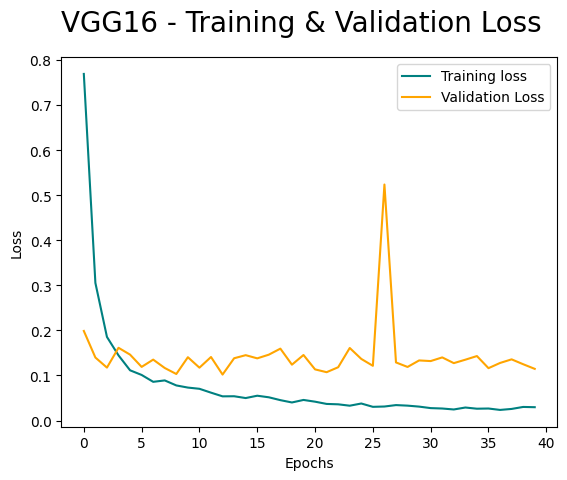

In [34]:
#Model Loss Plot
fig = plt.figure()
plt.plot(vgg16_history.history['loss'], color='teal', label ='loss')
plt.plot(vgg16_history.history['val_loss'], color='orange', label ='val_loss')
fig.suptitle('VGG16 - Training & Validation Loss', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['Training loss','Validation Loss'], loc = 'upper right')
plt.show()

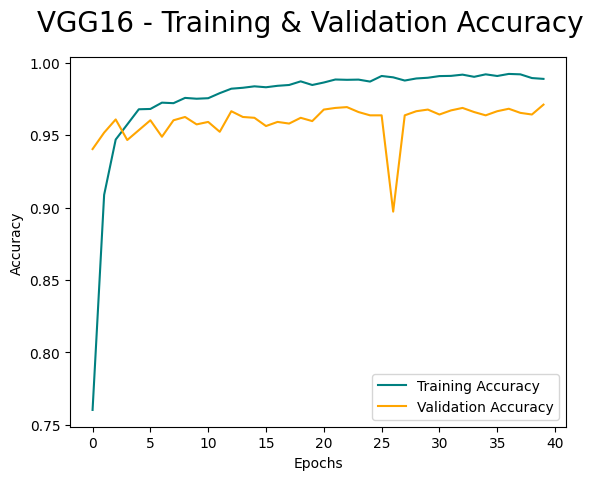

In [35]:
#Model Accuracy Plot
fig = plt.figure()
plt.plot(vgg16_history.history['accuracy'], color='teal', label ='accuracy')
plt.plot(vgg16_history.history['val_accuracy'], color='orange', label ='val_accuracy')
fig.suptitle('VGG16 - Training & Validation Accuracy', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['Training Accuracy','Validation Accuracy'], loc = 'lower right')
plt.show()

##### 2.2.3.2 Metrics

In [45]:
#Evaluate Model with Test Data
loss, acc = vgg16_model.evaluate(data_leaf_test)
print('Accuracy Test: ',acc)
print('Loss Test: ',loss)

55/55 [==============================] - 2s 38ms/step - loss: 0.0084 - accuracy: 0.9965
Accuracy Test:  0.9965397715568542
Loss Test:  0.00836392492055893


##### 2.1.4.3 Classification Report

In [46]:
#Classification Report --> Usinng Test Data
from sklearn.metrics import classification_report
test_images = []
test_labels = []

for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())

test_images = np.array(test_images)
test_labels = np.array(test_labels)

predictions = np.argmax(vgg16_model.predict(data_leaf_test), axis=-1)

predicted_class_names = [leaf_list[label] for label in predictions]
true_class_names = [leaf_list[label] for label in test_labels]
report = classification_report(true_class_names, predicted_class_names)
print(report)

55/55 [==============================] - 2s 39ms/step
                               precision    recall  f1-score   support

Leaves_apple_cedar_apple_rust       1.00      1.00      1.00       151
         Leaves_apple_healthy       1.00      1.00      1.00       215
            Leaves_apple_scab       1.00      0.99      0.99       148
       Leaves_grape_black_rot       1.00      0.99      1.00       172
         Leaves_grape_healthy       0.99      1.00      1.00       133
     Leaves_grape_leaf_blight       0.99      0.99      0.99       151
   Leaves_potato_early_blight       1.00      1.00      1.00       163
        Leaves_potato_healthy       0.99      0.99      0.99       157
    Leaves_potato_late_blight       0.99      1.00      1.00       149
    Leaves_strawberry_healthy       1.00      0.99      1.00       149
Leaves_strawberry_leaf_scorch       0.99      1.00      1.00       146

                     accuracy                           1.00      1734
                    m

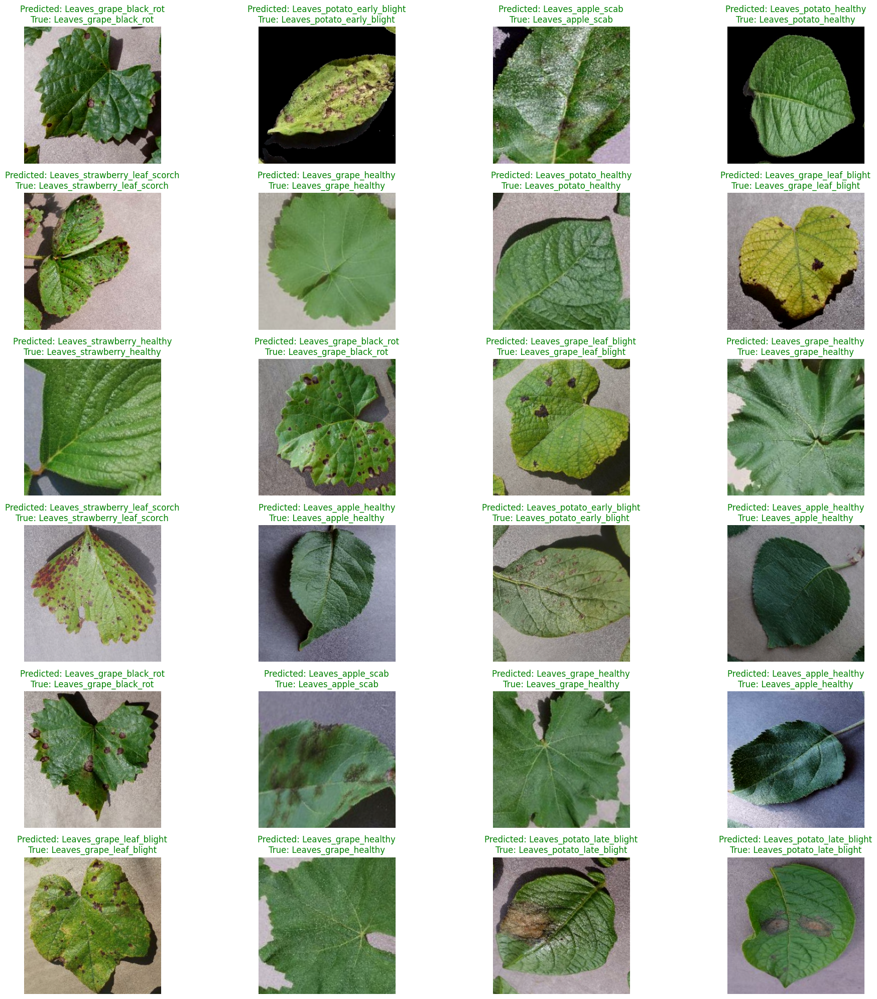

In [47]:
#Test Sample
plt.figure(figsize=(20, 20))
for i in range(24):
    ax = plt.subplot(6, 4, i + 1)
    plt.imshow(test_images[i])
    if predicted_class_names[i] == true_class_names[i]:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='green')
    else:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='red')
    plt.axis("off")
plt.tight_layout()
plt.show()

##### 2.1.4.3 Confusion Matrix

55/55 [==============================] - 2s 41ms/step


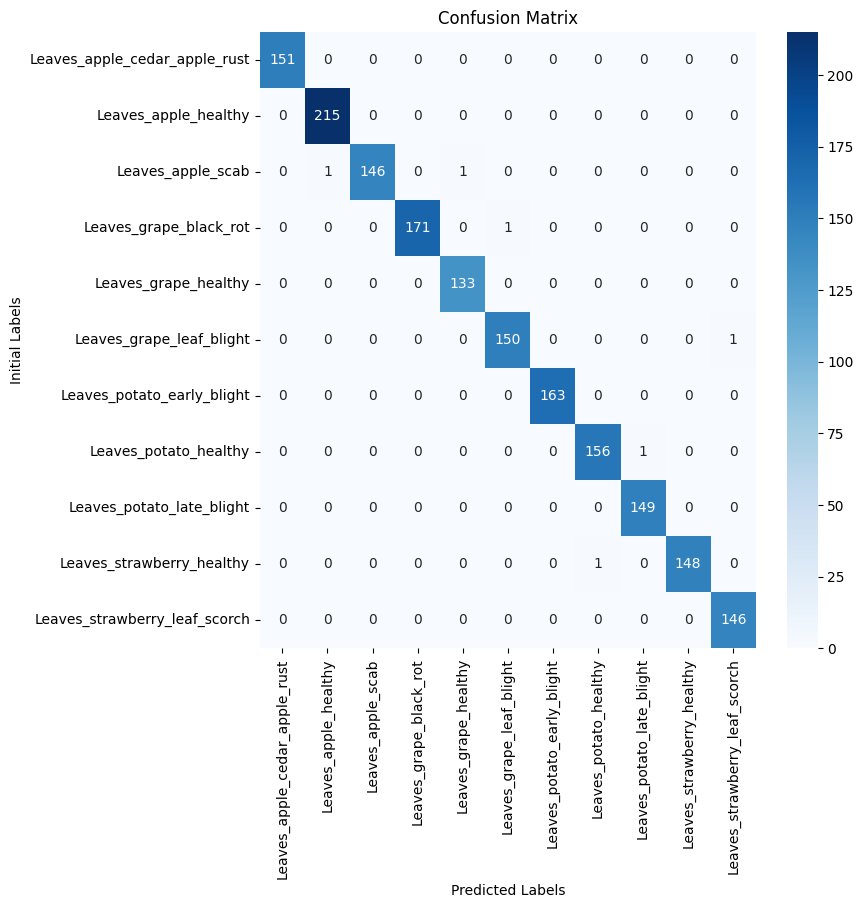

In [48]:
#Confusion Matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
test_images = []
test_labels = []
for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())
test_images = np.array(test_images)
test_labels = np.array(test_labels)
test_predictions = np.argmax(vgg16_model.predict(data_leaf_test), axis=-1)

cm = confusion_matrix(test_labels, test_predictions)
# Plot the confusion matrix
plt.figure(figsize=(8, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=leaf_list, yticklabels=leaf_list)
plt.xlabel("Predicted Labels")
plt.ylabel("Initial Labels")
plt.title("Confusion Matrix")
plt.show()

#### Cross Validation

In [11]:
#Early Stopping
from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='loss', patience=2, restore_best_weights=False)

# Define lists to store evaluation metrics
validation_losses = []
validation_accuracies = []

# Define the number of folds
k = 5

# Get the total number of samples in your dataset
num_samples = len(data_leaf)

# Calculate the number of samples in each fold
fold_size = num_samples // k

# Shuffle the data
data_leaf = data_leaf.shuffle(num_samples, reshuffle_each_iteration=False)

# Perform k-fold cross-validation
for fold in range(k):
    print(f"Processing fold {fold + 1}/{k}")
    
    # Determine the starting and ending indices for the current fold
    start_idx = fold * fold_size
    end_idx = (fold + 1) * fold_size if fold < k - 1 else num_samples

    # Split the data into training and validation sets for the current fold
    validation_data = data_leaf.skip(start_idx).take(fold_size)
    training_data = data_leaf.take(start_idx).concatenate(data_leaf.skip(end_idx))

    # Define and compile your model
    model = create_model_1()  # Replace with your own model creation function
    
    # Train the model on the training data
    model.fit(training_data, epochs=epochs, callbacks=[early_stopping])
    
    # Evaluate the model on the validation data
    validation_loss, validation_accuracy = model.evaluate(validation_data)
    validation_losses.append(validation_loss)
    validation_accuracies.append(validation_accuracy)
    print(f"\nValidation Loss: {validation_loss:.4f}")
    print(f"Validation Accuracy: {validation_accuracy:.4f}\n")


# Calculate the overall metrics
overall_loss = np.mean(validation_losses)
overall_accuracy = np.mean(validation_accuracies)

print("Overall Metrics")
print(f"Overall Loss: {overall_loss:.4f}")
print(f"Overall Accuracy: {overall_accuracy:.4f}")

Processing fold 1/5
Epoch 1/40
439/439 [==============================] - 190s 246ms/step - loss: 0.7272 - accuracy: 0.7711
Epoch 2/40
439/439 [==============================] - 174s 235ms/step - loss: 0.3456 - accuracy: 0.8908
Epoch 3/40
439/439 [==============================] - 180s 234ms/step - loss: 0.2668 - accuracy: 0.9159
Epoch 4/40
439/439 [==============================] - 177s 233ms/step - loss: 0.2291 - accuracy: 0.9272
Epoch 5/40
439/439 [==============================] - 175s 231ms/step - loss: 0.2165 - accuracy: 0.9312
Epoch 6/40
439/439 [==============================] - 175s 231ms/step - loss: 0.1896 - accuracy: 0.9384
Epoch 7/40
439/439 [==============================] - 174s 231ms/step - loss: 0.1940 - accuracy: 0.9362
Epoch 8/40
439/439 [==============================] - 176s 232ms/step - loss: 0.1662 - accuracy: 0.9473
Epoch 9/40
439/439 [==============================] - 174s 231ms/step - loss: 0.1671 - accuracy: 0.9453
Epoch 10/40
439/439 [=======================

### 2.3 ResNet50

#### 2.3.1  ResNet50  - Build

In [8]:
def create_model_2():
    resnet50_model = ResNet50(pooling = 'avg', include_top=False, input_shape=(img_width, img_height, 3))

    # Freeze Layers
    for layer in resnet50_model.layers:
        layer.trainable = False

    # Add custom layers on top of ResNet50
    x = Flatten()(resnet50_model.output)
    x = Dense(1024, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)
    x = Dense(32, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)

    # Output Layer
    output = Dense(leaf_num, activation='softmax')(x)

    # Create the model
    resnet50_model = tf.keras.Model(inputs=resnet50_model.input, outputs=output)


    # Compile Model
    initial_learning_rate = 0.001
    resnet50_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=initial_learning_rate), loss="sparse_categorical_crossentropy", metrics=['accuracy'])
    
    return resnet50_model

In [9]:
resnet50_model = create_model_2()

In [10]:
#Display Model Summary
resnet50_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 262, 262, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 128, 128, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

                                                                                                  
 conv2_block3_1_relu (Activatio  (None, 64, 64, 64)  0           ['conv2_block3_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv2_block3_2_conv (Conv2D)   (None, 64, 64, 64)   36928       ['conv2_block3_1_relu[0][0]']    
                                                                                                  
 conv2_block3_2_bn (BatchNormal  (None, 64, 64, 64)  256         ['conv2_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block3_2_relu (Activatio  (None, 64, 64, 64)  0           ['conv2_block3_2_bn[0][0]']      
 n)       

                                                                                                  
 conv3_block3_1_relu (Activatio  (None, 32, 32, 128)  0          ['conv3_block3_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block3_2_conv (Conv2D)   (None, 32, 32, 128)  147584      ['conv3_block3_1_relu[0][0]']    
                                                                                                  
 conv3_block3_2_bn (BatchNormal  (None, 32, 32, 128)  512        ['conv3_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block3_2_relu (Activatio  (None, 32, 32, 128)  0          ['conv3_block3_2_bn[0][0]']      
 n)       

                                                                                                  
 conv4_block2_1_bn (BatchNormal  (None, 16, 16, 256)  1024       ['conv4_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block2_1_relu (Activatio  (None, 16, 16, 256)  0          ['conv4_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, 16, 16, 256)  590080      ['conv4_block2_1_relu[0][0]']    
                                                                                                  
 conv4_block2_2_bn (BatchNormal  (None, 16, 16, 256)  1024       ['conv4_block2_2_conv[0][0]']    
 ization) 

 conv4_block5_1_conv (Conv2D)   (None, 16, 16, 256)  262400      ['conv4_block4_out[0][0]']       
                                                                                                  
 conv4_block5_1_bn (BatchNormal  (None, 16, 16, 256)  1024       ['conv4_block5_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block5_1_relu (Activatio  (None, 16, 16, 256)  0          ['conv4_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block5_2_conv (Conv2D)   (None, 16, 16, 256)  590080      ['conv4_block5_1_relu[0][0]']    
                                                                                                  
 conv4_blo

                                                                  'conv5_block1_3_bn[0][0]']      
                                                                                                  
 conv5_block1_out (Activation)  (None, 8, 8, 2048)   0           ['conv5_block1_add[0][0]']       
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, 8, 8, 512)    1049088     ['conv5_block1_out[0][0]']       
                                                                                                  
 conv5_block2_1_bn (BatchNormal  (None, 8, 8, 512)   2048        ['conv5_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_1_relu (Activatio  (None, 8, 8, 512)   0           ['conv5_block2_1_bn[0][0]']      
 n)       

#### 2.3.2  ResNet50  - Train

In [21]:
#TensorBoard Logs =--> Check Points to Check How Model Perform
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = leaf_logdir)

#Early Stopping
# from tensorflow.keras.callbacks import EarlyStopping
# early_stopping = EarlyStopping(monitor='val_accuracy', patience=2, restore_best_weights=True)

#Model Checkpoint
from tensorflow.keras.callbacks import ModelCheckpoint
model_cp = ModelCheckpoint(os.path.join(model_dir, cnn_leaf_res50_cp), monitor='val_accuracy', verbose = 1, save_best_only=True, mode='max')

In [22]:
#Run Model (Train) --> epochs = how long train will run... 1 epochs = 1 full run (all batches)
res50_history = resnet50_model.fit(data_leaf_train, epochs=epochs, validation_data=data_leaf_val, callbacks=[tensorboard_callback, model_cp])

Epoch 1/40
438/438 [==============================] - ETA: 0s - loss: 1.9876 - accuracy: 0.3455
Epoch 1: val_accuracy improved from -inf to 0.23523, saving model to models\CNN-LEAF-RESNET50-Epoch-01.h5
438/438 [==============================] - 222s 335ms/step - loss: 1.9876 - accuracy: 0.3455 - val_loss: 3.4834 - val_accuracy: 0.2352
Epoch 2/40
438/438 [==============================] - ETA: 0s - loss: 1.4888 - accuracy: 0.4849
Epoch 2: val_accuracy did not improve from 0.23523
438/438 [==============================] - 88s 202ms/step - loss: 1.4888 - accuracy: 0.4849 - val_loss: 6.9335 - val_accuracy: 0.1955
Epoch 3/40
438/438 [==============================] - ETA: 0s - loss: 1.3540 - accuracy: 0.5308
Epoch 3: val_accuracy improved from 0.23523 to 0.24261, saving model to models\CNN-LEAF-RESNET50-Epoch-03.h5
438/438 [==============================] - 75s 171ms/step - loss: 1.3540 - accuracy: 0.5308 - val_loss: 5.6265 - val_accuracy: 0.2426
Epoch 4/40
438/438 [=======================

Epoch 29/40
438/438 [==============================] - ETA: 0s - loss: 0.9137 - accuracy: 0.6909
Epoch 29: val_accuracy improved from 0.35568 to 0.36193, saving model to models\CNN-LEAF-RESNET50-Epoch-29.h5
438/438 [==============================] - 74s 170ms/step - loss: 0.9137 - accuracy: 0.6909 - val_loss: 3.1180 - val_accuracy: 0.3619
Epoch 30/40
438/438 [==============================] - ETA: 0s - loss: 0.9291 - accuracy: 0.6888
Epoch 30: val_accuracy did not improve from 0.36193
438/438 [==============================] - 74s 168ms/step - loss: 0.9291 - accuracy: 0.6888 - val_loss: 5.8904 - val_accuracy: 0.2102
Epoch 31/40
438/438 [==============================] - ETA: 0s - loss: 0.8876 - accuracy: 0.6965
Epoch 31: val_accuracy did not improve from 0.36193
438/438 [==============================] - 73s 168ms/step - loss: 0.8876 - accuracy: 0.6965 - val_loss: 8.6413 - val_accuracy: 0.1847
Epoch 32/40
438/438 [==============================] - ETA: 0s - loss: 0.8966 - accuracy: 0.6

In [23]:
#Print History
res50_history.history

{'loss': [1.987632155418396,
  1.4887994527816772,
  1.3539519309997559,
  1.2770823240280151,
  1.2390942573547363,
  1.1932506561279297,
  1.1706345081329346,
  1.1287225484848022,
  1.0992960929870605,
  1.0751957893371582,
  1.0649439096450806,
  1.0436795949935913,
  1.0369280576705933,
  1.0148887634277344,
  1.017482876777649,
  0.9961128234863281,
  0.995805561542511,
  0.9695427417755127,
  0.9831238389015198,
  0.9552070498466492,
  0.9564827680587769,
  0.9590689539909363,
  0.9449636340141296,
  0.9432639479637146,
  0.9360801577568054,
  0.922900915145874,
  0.9210390448570251,
  0.9174503684043884,
  0.9136597514152527,
  0.9291465282440186,
  0.887594997882843,
  0.8965966105461121,
  0.8834765553474426,
  0.889560878276825,
  0.8793789148330688,
  0.8696476221084595,
  0.867008626461029,
  0.8700675368309021,
  0.8631134629249573,
  0.8584051132202148],
 'accuracy': [0.34553366899490356,
  0.484874427318573,
  0.5308219194412231,
  0.5635702013969421,
  0.57320207357406

In [24]:
#Model History in Dataframe
res50_history_df = pd.DataFrame(res50_history.history)
res50_history_df

,loss,accuracy,val_loss,val_accuracy
0,1.987632,0.345534,3.483449,0.235227
1,1.488799,0.484874,6.933459,0.195455
2,1.353952,0.530822,5.626456,0.242614
3,1.277082,0.563570,6.245059,0.236932
4,1.239094,0.573202,3.852362,0.296023
5,1.193251,0.592608,4.082976,0.192045
6,1.170635,0.602454,4.202680,0.345455
7,1.128723,0.614726,9.908827,0.118182
8,1.099296,0.630208,6.766279,0.143750
9,1.075196,0.634632,3.628025,0.355682


#### 2.3.3  ResNet50  - Evaluate

##### 2.3.3.1 Plot Performance

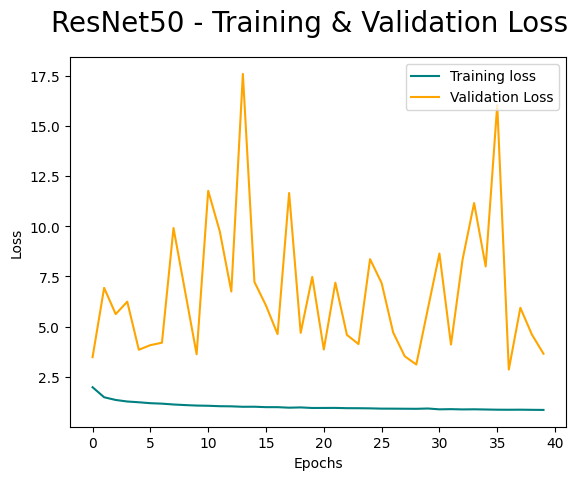

In [25]:
#Model Loss Plot
fig = plt.figure()
plt.plot(res50_history.history['loss'], color='teal', label ='loss')
plt.plot(res50_history.history['val_loss'], color='orange', label ='val_loss')
fig.suptitle('ResNet50 - Training & Validation Loss', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['Training loss','Validation Loss'], loc = 'upper right')
plt.show()

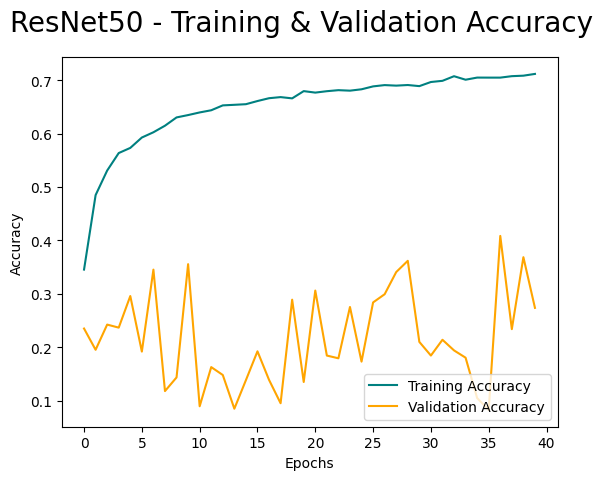

In [26]:
#Model Accuracy Plot
fig = plt.figure()
plt.plot(res50_history.history['accuracy'], color='teal', label ='accuracy')
plt.plot(res50_history.history['val_accuracy'], color='orange', label ='val_accuracy')
fig.suptitle('ResNet50 - Training & Validation Accuracy', fontsize=20)
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['Training Accuracy','Validation Accuracy'], loc = 'lower right')
plt.show()

##### 2.3.3.2 Metrics

In [40]:
#Evaluate Model with Test Data
loss, acc = resnet50_model.evaluate(data_leaf_test)
print('Accuracy Test: ',acc)
print('Loss Test: ',loss)

55/55 [==============================] - 78s 249ms/step - loss: 2.9443 - accuracy: 0.3919
Accuracy Test:  0.3838672637939453
Loss Test:  2.9442543983459473



##### 2.3.3.1 Classfication Report

In [29]:
#Classification Report --> Usinng Test Data
from sklearn.metrics import classification_report
test_images = []
test_labels = []

for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())

test_images = np.array(test_images)
test_labels = np.array(test_labels)

predictions = np.argmax(resnet50_model.predict(data_leaf_test), axis=-1)

predicted_class_names = [leaf_list[label] for label in predictions]
true_class_names = [leaf_list[label] for label in test_labels]
report = classification_report(true_class_names, predicted_class_names)
print(report)

55/55 [==============================] - 10s 144ms/step
                               precision    recall  f1-score   support

Leaves_apple_cedar_apple_rust       0.84      0.67      0.74       154
         Leaves_apple_healthy       0.46      0.93      0.62       211
            Leaves_apple_scab       0.17      0.81      0.28       136
       Leaves_grape_black_rot       0.97      0.20      0.33       169
         Leaves_grape_healthy       0.00      0.00      0.00       133
     Leaves_grape_leaf_blight       1.00      0.02      0.04       150
   Leaves_potato_early_blight       0.82      0.43      0.56       163
        Leaves_potato_healthy       0.00      0.00      0.00       147
    Leaves_potato_late_blight       0.39      0.13      0.20       159
    Leaves_strawberry_healthy       1.00      0.02      0.04       164
Leaves_strawberry_leaf_scorch       0.40      0.89      0.55       162

                     accuracy                           0.39      1748
                   

C:\Users\Viz12\anaconda3\envs\tensorflowgpu\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Viz12\anaconda3\envs\tensorflowgpu\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Viz12\anaconda3\envs\tensorflowgpu\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result)

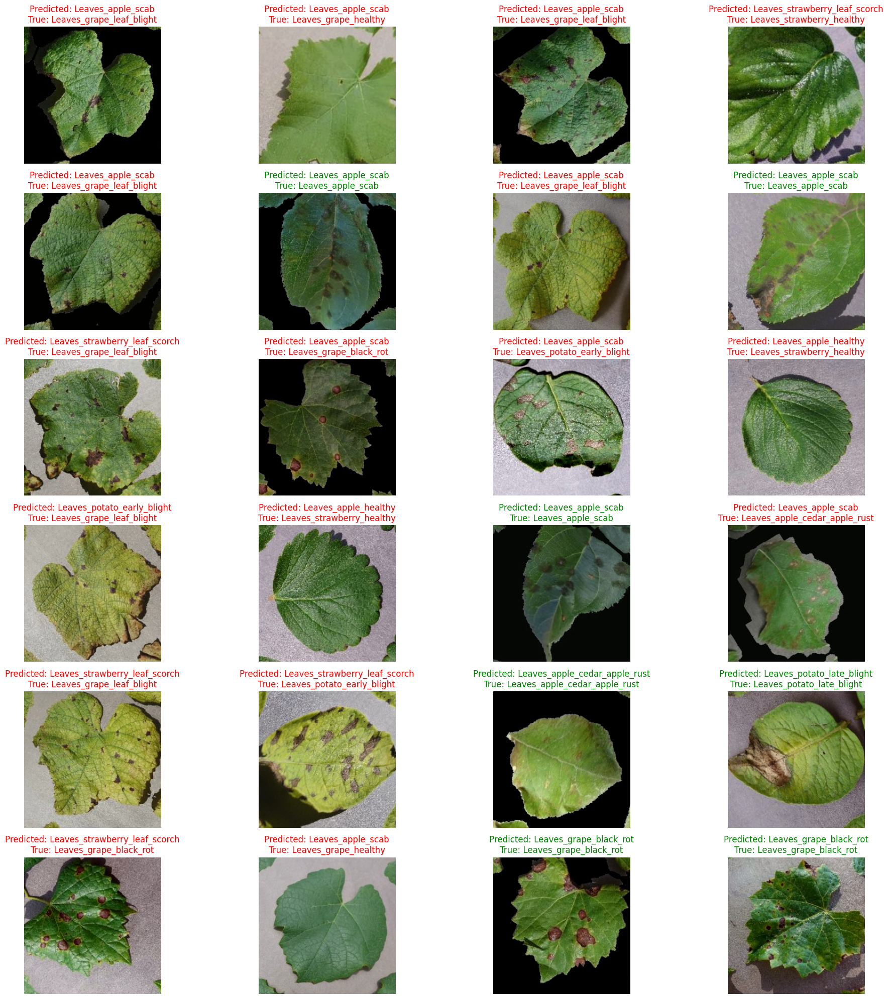

In [30]:
#Test Sample
plt.figure(figsize=(20, 20))
for i in range(24):
    ax = plt.subplot(6, 4, i + 1)
    plt.imshow(test_images[i])
    if predicted_class_names[i] == true_class_names[i]:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='green')
    else:
        plt.title(f"Predicted: {predicted_class_names[i]}\nTrue: {true_class_names[i]}", color='red')
    plt.axis("off")
plt.tight_layout()
plt.show()

##### 2.3.3.1 Confusion Matrix

55/55 [==============================] - 8s 145ms/step


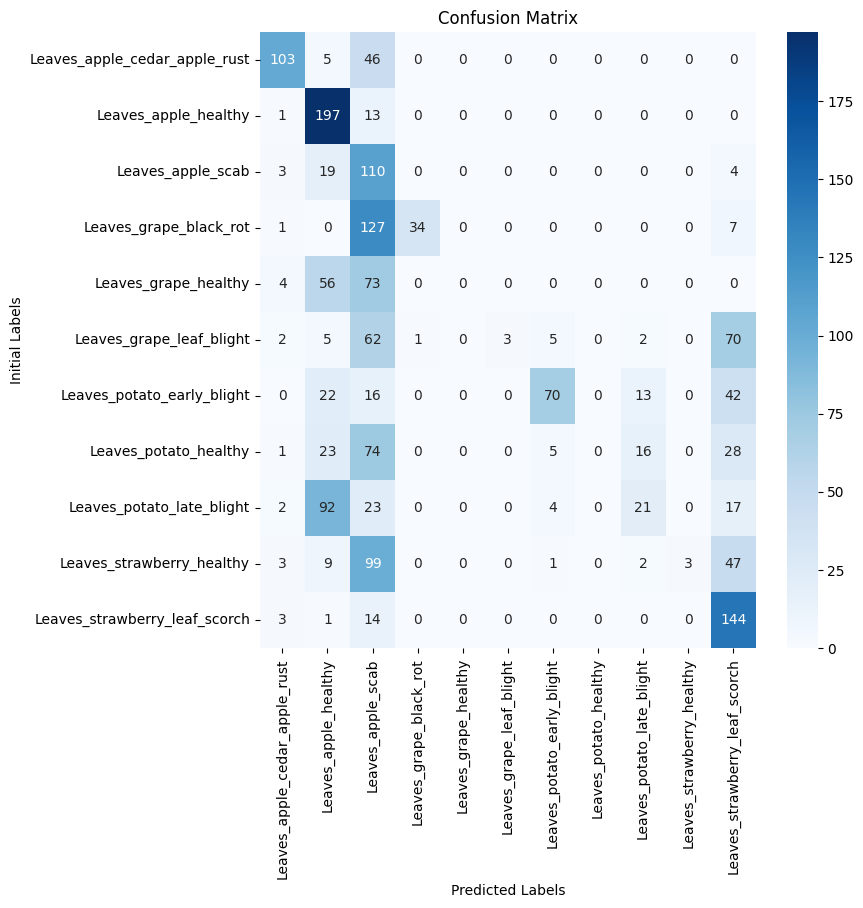

In [31]:
#Confusion Matrix
from sklearn.metrics import confusion_matrix
import seaborn as sns
test_images = []
test_labels = []
for images, labels in data_leaf_test:
    test_images.extend(images.numpy())
    test_labels.extend(labels.numpy())
test_images = np.array(test_images)
test_labels = np.array(test_labels)
test_predictions = np.argmax(resnet50_model.predict(data_leaf_test), axis=-1)

cm = confusion_matrix(test_labels, test_predictions)
# Plot the confusion matrix
plt.figure(figsize=(8, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=leaf_list, yticklabels=leaf_list)
plt.xlabel("Predicted Labels")
plt.ylabel("Initial Labels")
plt.title("Confusion Matrix")
plt.show()

## 3.0 Save Model

In [26]:
#Save model
from tensorflow.keras.models import load_model
leaf_model.save(os.path.join(model_dir, cnn_leaf))
vgg16_model.save(os.path.join(model_dir, cnn_leaf_vgg16))
resnet50_model.save(os.path.join(model_dir, cnn_leaf_res50))

## 4.0 Load Model

In [4]:
#Load Model
from tensorflow.keras.models import load_model
loaded_model = load_model(os.path.join(model_dir, cnn_leaf))
loaded_model_1 = load_model(os.path.join(model_dir, cnn_leaf_vgg16))
loaded_model_2 = load_model(os.path.join(model_dir, cnn_leaf_res50))